Data Loading and Preprocessing

In [1]:
import pandas as pd
import numpy as np
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import linkage, fcluster, dendrogram
from sklearn.preprocessing import LabelEncoder

# Load the dataset
info_A1 = pd.read_csv(r"C:\Users\pingk\Downloads\fadhli nitip\asik6a.csv")

# Function to remove outliers
def remove_outliers_v2(df):
    numeric_cols = df.select_dtypes(include=['number']).columns
    df_numeric = df[numeric_cols]
    
    iso = IsolationForest(contamination=0.05, random_state=42)
    yhat = iso.fit_predict(df_numeric)
    mask = yhat != -1
    df_cleaned = df[mask].reset_index(drop=True)
    return df_cleaned

# Remove outliers
df_cleaned_v2 = remove_outliers_v2(info_A1)

# Identify numeric and string columns
numeric_cols_v2 = df_cleaned_v2.select_dtypes(include=[np.number]).columns.tolist()
string_cols_v2 = df_cleaned_v2.select_dtypes(exclude=[np.number]).columns.tolist()

# Standardize the numeric data
scaler_v2 = StandardScaler()
scaled_data_v2 = scaler_v2.fit_transform(df_cleaned_v2[numeric_cols_v2])


Clustering

In [2]:
# Perform GMM clustering
gmm_v2 = GaussianMixture(n_components=2, random_state=42)
clusters_gmm_v2 = gmm_v2.fit_predict(scaled_data_v2)

# Perform KMeans clustering
kmeans_v2 = KMeans(n_clusters=2, random_state=42)
clusters_kmeans_v2 = kmeans_v2.fit_predict(scaled_data_v2)

# Perform HCA clustering
linkage_matrix_v2 = linkage(scaled_data_v2, method='ward')
clusters_hca_v2 = fcluster(linkage_matrix_v2, t=2, criterion='maxclust')

# Create DataFrames for the clusters
clusters_df_gmm_v2 = pd.DataFrame(data=clusters_gmm_v2, columns=['Cluster_GMM'])
clusters_df_kmeans_v2 = pd.DataFrame(data=clusters_kmeans_v2, columns=['Cluster_KMeans'])
clusters_df_hca_v2 = pd.DataFrame(data=clusters_hca_v2, columns=['Cluster_HCA'])

# Create a DataFrame from the scaled numeric data
scaled_df_v2 = pd.DataFrame(scaled_data_v2, columns=numeric_cols_v2)

# Concatenate the string columns, scaled numeric data, and cluster labels for visualization purposes
reskm_df_v2 = pd.concat([df_cleaned_v2[string_cols_v2], scaled_df_v2, clusters_df_gmm_v2, clusters_df_kmeans_v2, clusters_df_hca_v2], axis=1)

# Display the resulting DataFrame
print(reskm_df_v2.head())


  prov_char country_char               wavenumber tgp_name dgp_name fgp_name  \
0       BBX           ID  ID-BBX-068-2306-011_001  Group 3  Group 2  Group 3   
1       BBX           ID  ID-BBX-068-2306-011_002  Group 3  Group 2  Group 3   
2       BBX           ID  ID-BBX-068-2306-011_003  Group 3  Group 2  Group 3   
3       BBX           ID  ID-BBX-068-2306-011_004  Group 3  Group 2  Group 3   
4       BBX           ID  ID-BBX-068-2306-011_005  Group 3  Group 2  Group 3   

  country_name thnoth_name   649.893   650.376  ...   3997.23  3997.712  \
0    Indonesia    Non-Thai -0.113344  0.066692  ... -0.578246 -0.605511   
1    Indonesia    Non-Thai  0.353404  0.392921  ... -0.357749 -0.369140   
2    Indonesia    Non-Thai  0.096520 -0.007708  ... -0.840438 -0.841061   
3    Indonesia    Non-Thai -0.458375 -0.723290  ... -0.380415 -0.264219   
4    Indonesia    Non-Thai  0.904286  0.884453  ... -0.490562 -0.380669   

   3998.194  3998.676  3999.158   3999.64  4000.122  Cluster_GMM  \


PCA

In [3]:
# Perform PCA with 10 components
n_components_v2 = 10
pca_v2 = PCA(n_components=n_components_v2)
principal_components_v2 = pca_v2.fit_transform(scaled_data_v2)

# Create a DataFrame for the principal components
pca_df_v2 = pd.DataFrame(data=principal_components_v2, columns=[f'Principal Component {i+1}' for i in range(n_components_v2)])

# Add the cluster labels to the PCA DataFrame
pca_df_v2['Cluster_GMM'] = clusters_gmm_v2
pca_df_v2['Cluster_KMeans'] = clusters_kmeans_v2
pca_df_v2['Cluster_HCA'] = clusters_hca_v2

# Concatenate the string columns for visualization purposes
result_df_v2 = pd.concat([df_cleaned_v2[string_cols_v2], pca_df_v2], axis=1)


Plotting PCA Components

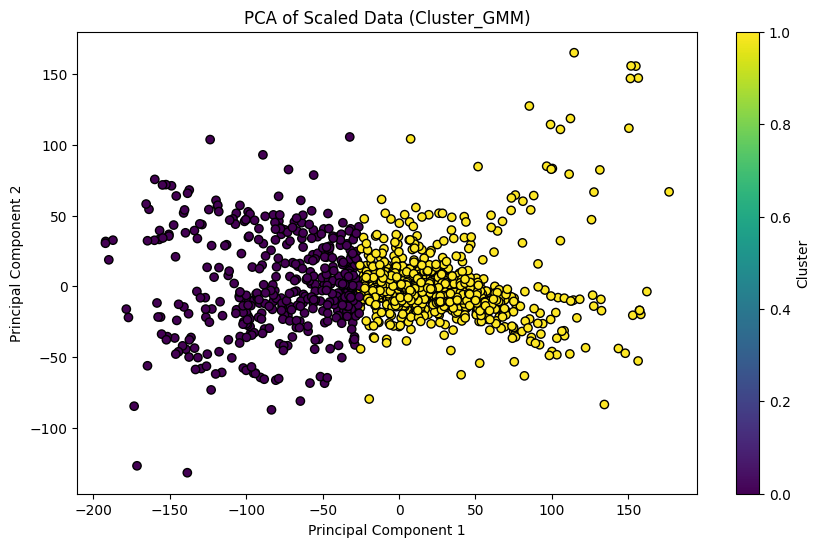

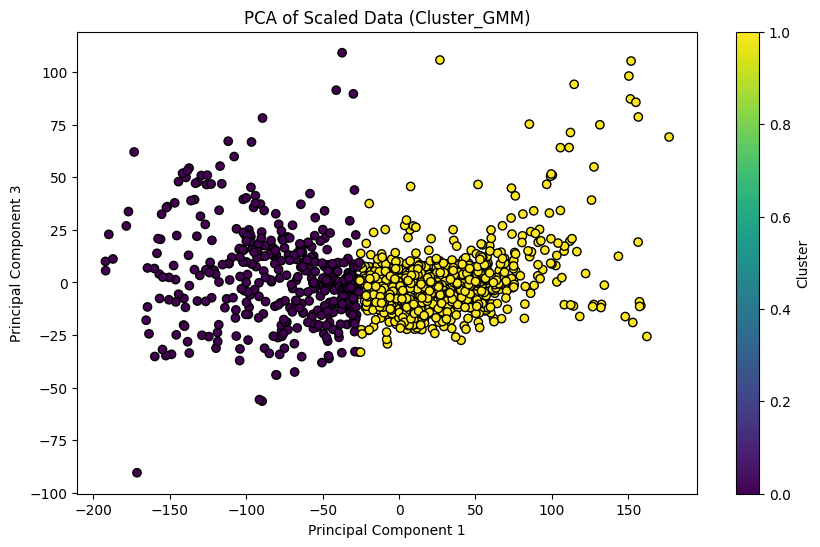

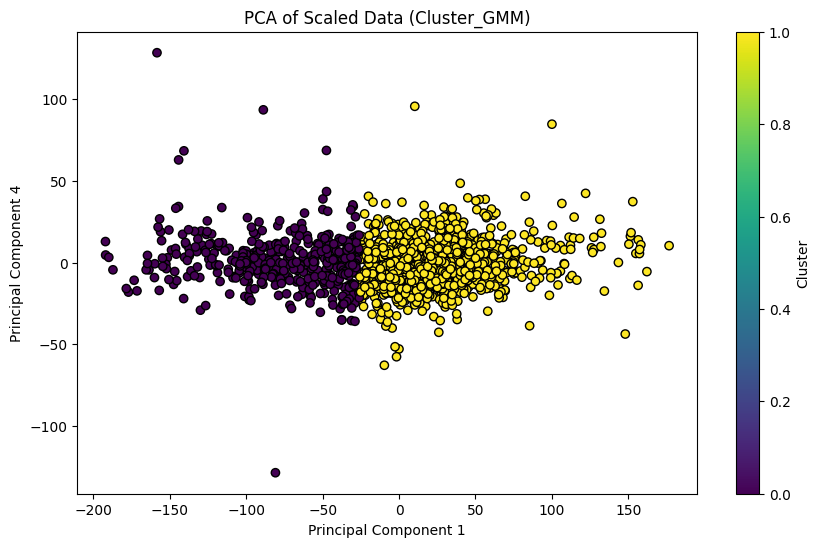

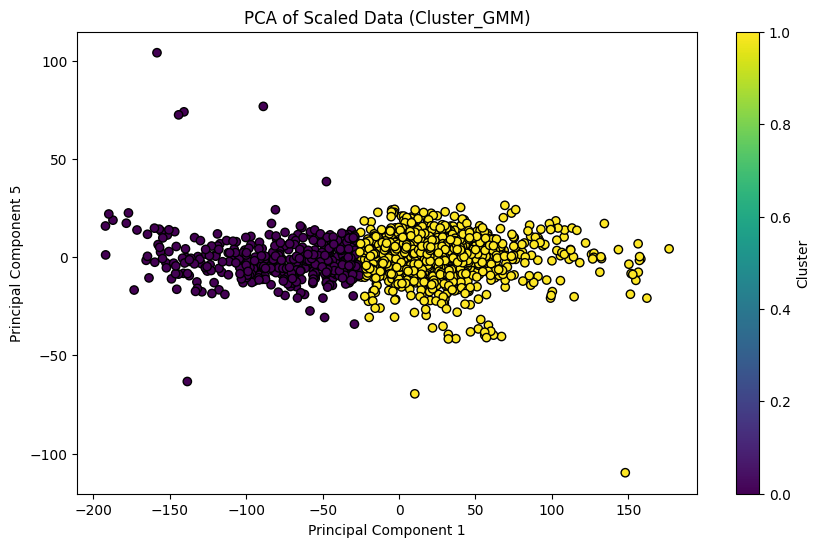

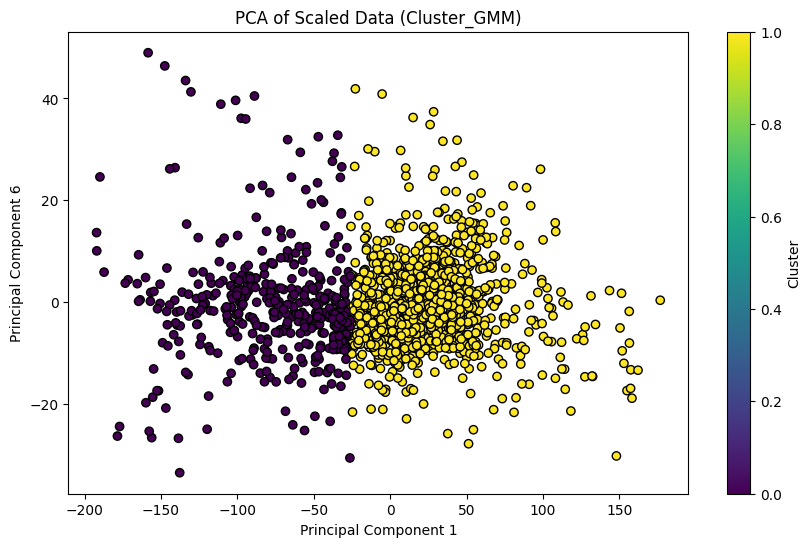

...

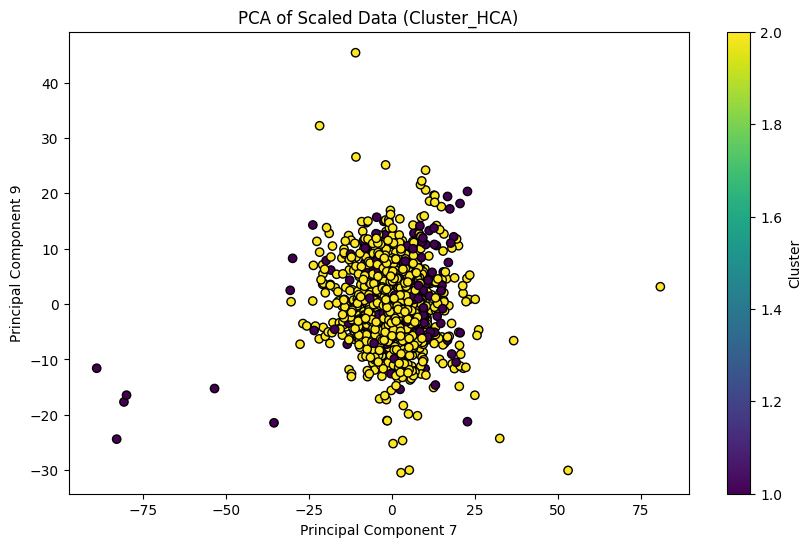

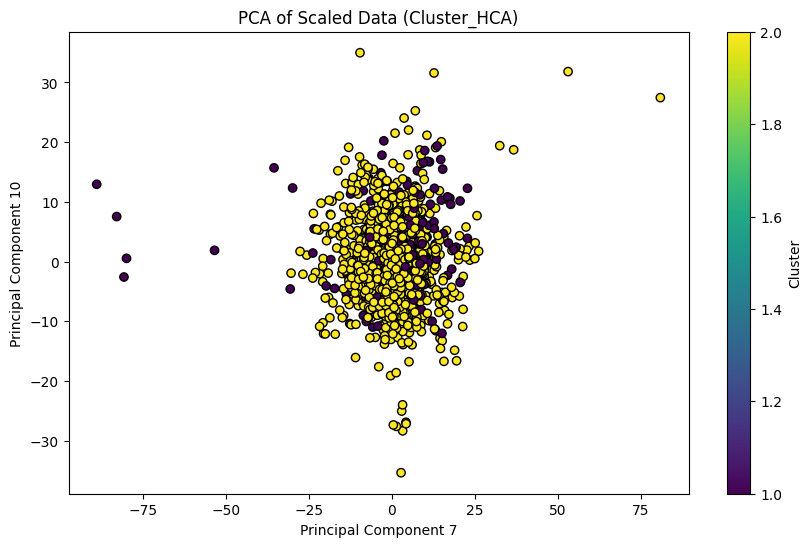

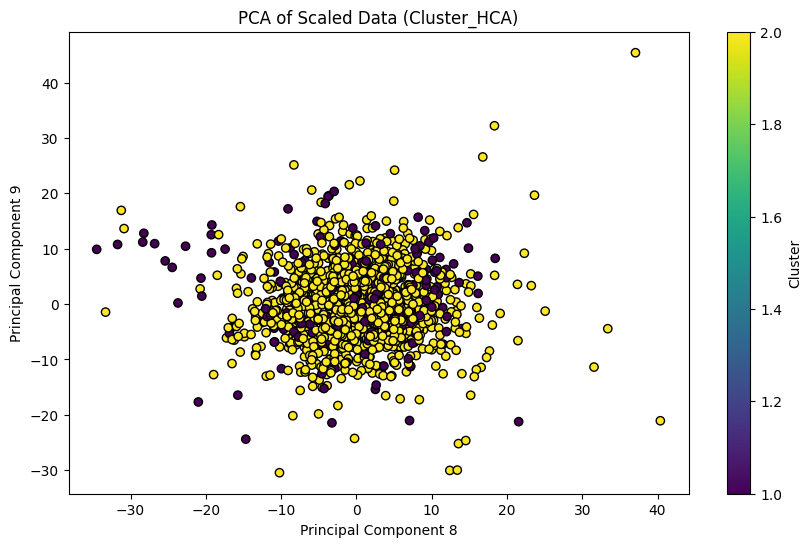

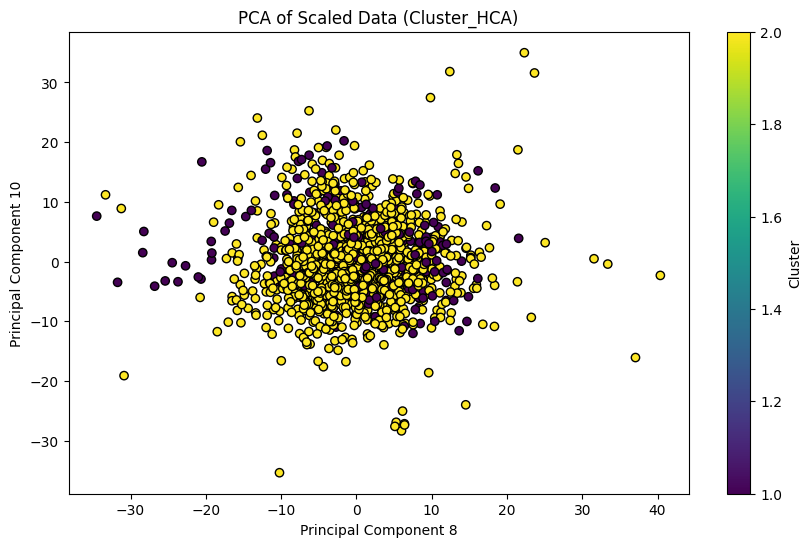

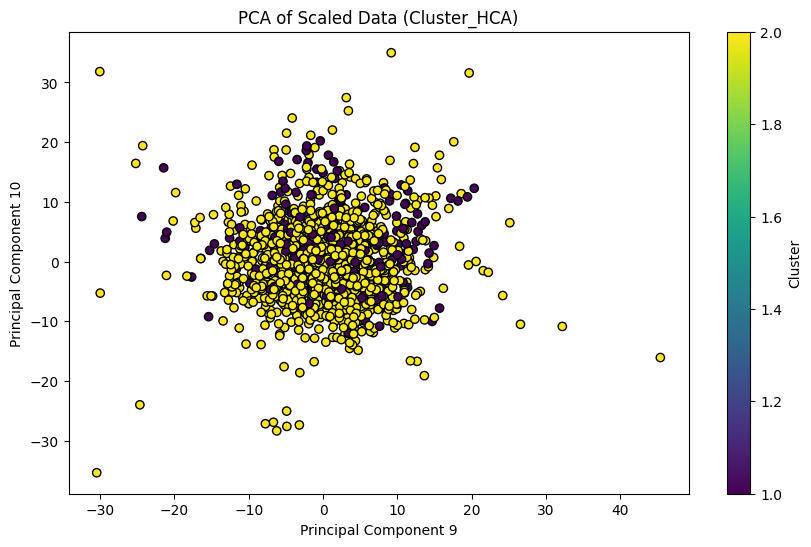

In [4]:
# Function to plot PCA results
def plot_pca_components_v2(df, clusters_col, n_components):
    for i in range(n_components):
        for j in range(i+1, n_components):
            plt.figure(figsize=(10, 6))
            plt.scatter(df[f'Principal Component {i+1}'], df[f'Principal Component {j+1}'], c=df[clusters_col], cmap='viridis', marker='o', edgecolor='k')
            plt.xlabel(f'Principal Component {i+1}')
            plt.ylabel(f'Principal Component {j+1}')
            plt.title(f'PCA of Scaled Data ({clusters_col})')
            plt.colorbar(label='Cluster')
            plt.show()

# Plot PCA components
plot_pca_components_v2(pca_df_v2, 'Cluster_GMM', n_components_v2)
plot_pca_components_v2(pca_df_v2, 'Cluster_KMeans', n_components_v2)
plot_pca_components_v2(pca_df_v2, 'Cluster_HCA', n_components_v2)


HCA Dendrogram

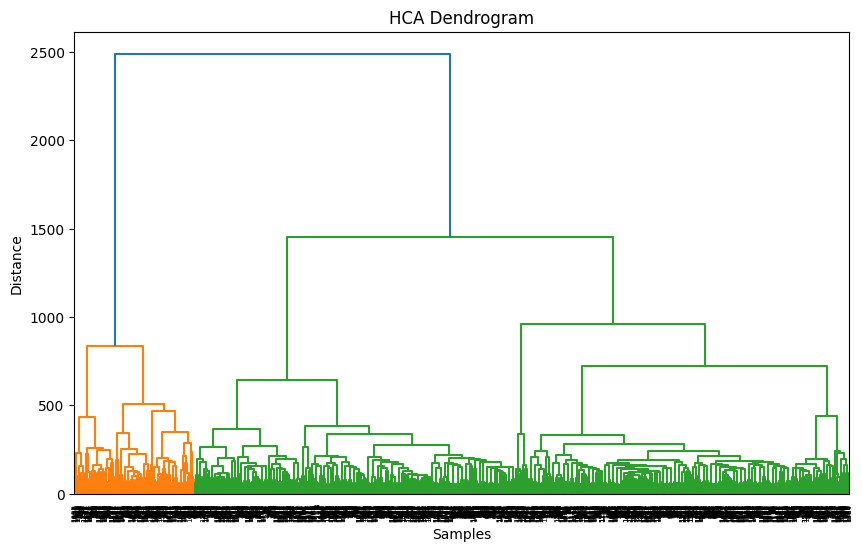

In [5]:
# Function to plot HCA dendrogram
def plot_hca_dendrogram_v2(linkage_matrix):
    plt.figure(figsize=(10, 6))
    dendrogram(linkage_matrix)
    plt.title('HCA Dendrogram')
    plt.xlabel('Samples')
    plt.ylabel('Distance')
    plt.show()

# Plot HCA dendrogram
plot_hca_dendrogram_v2(linkage_matrix_v2)


Specific PCA Pairs

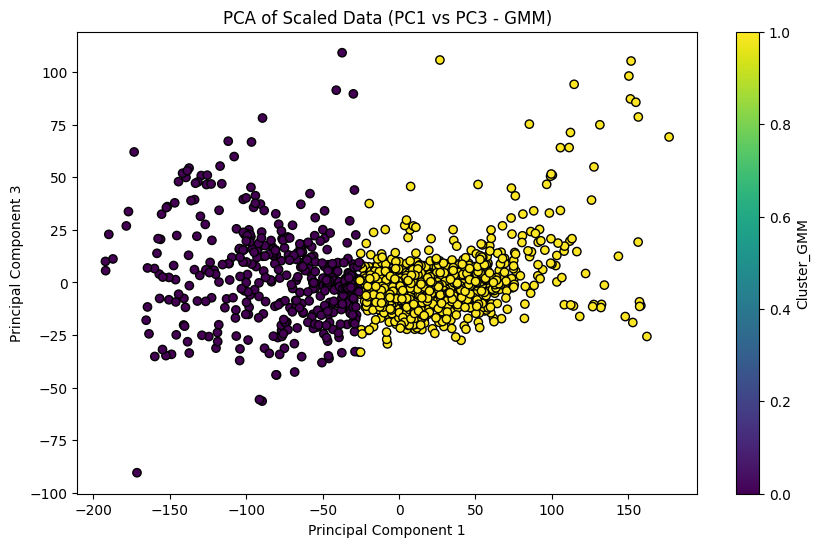

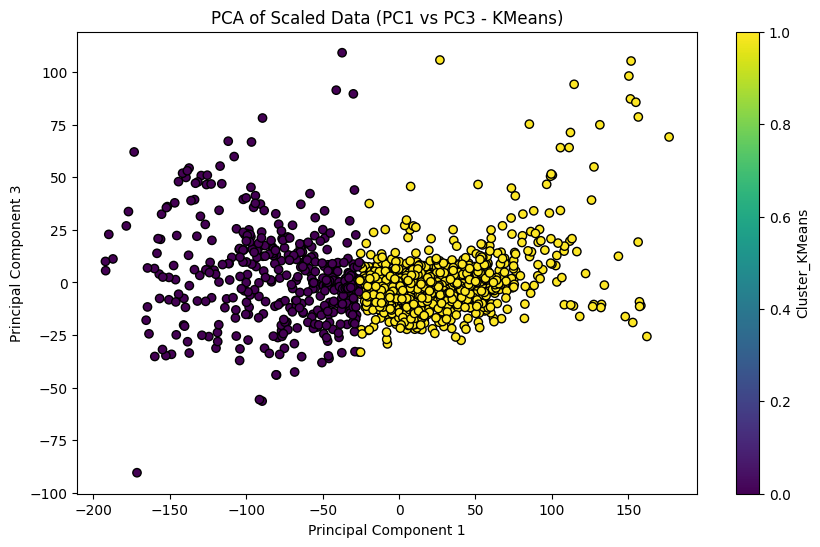

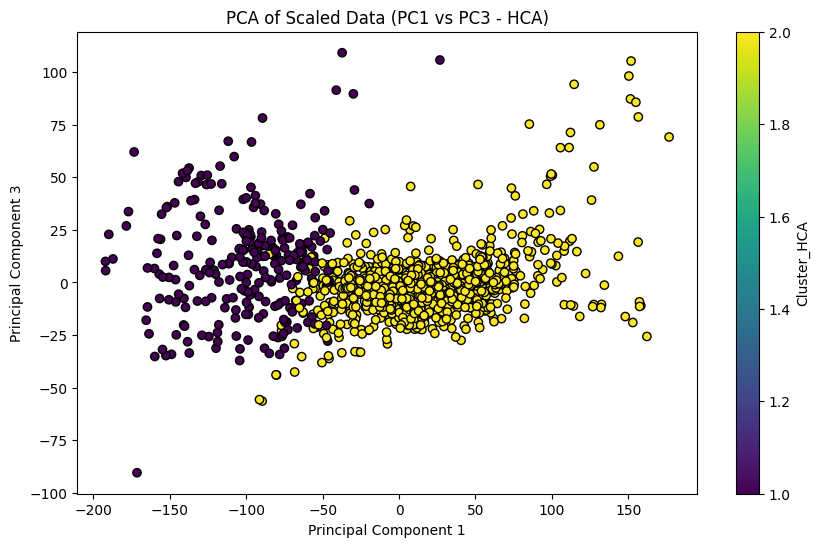

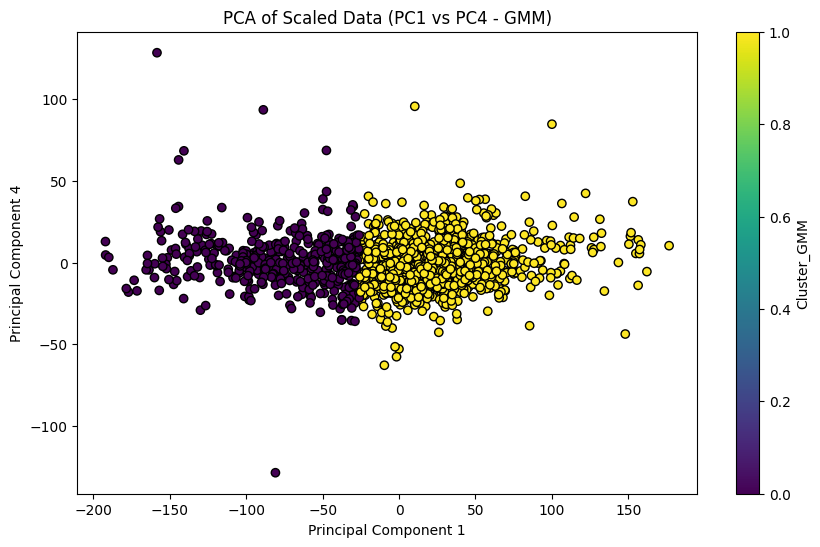

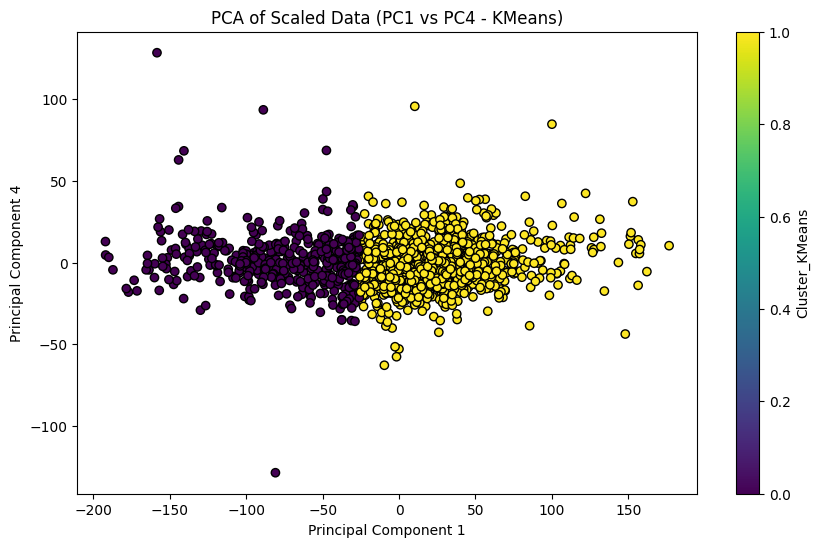

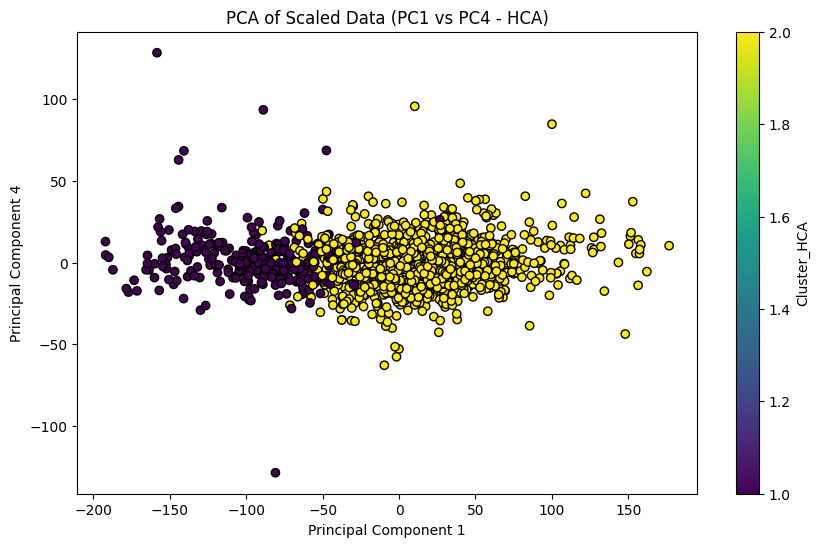

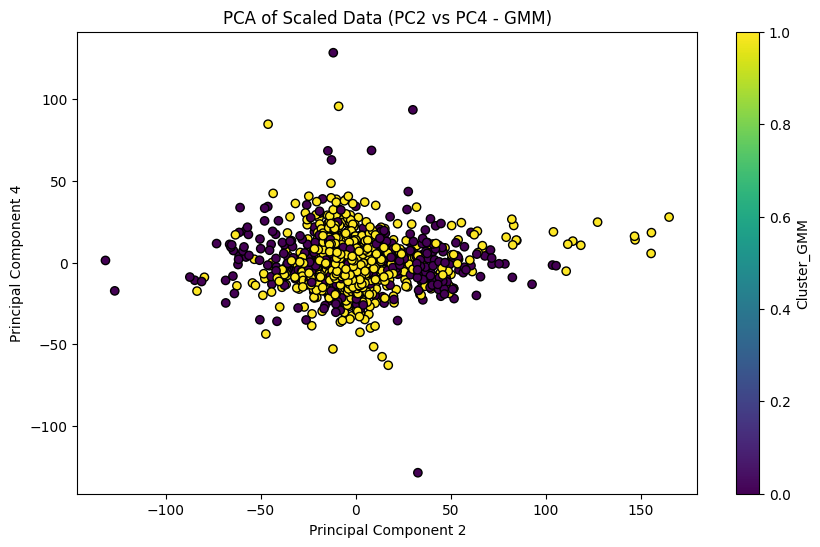

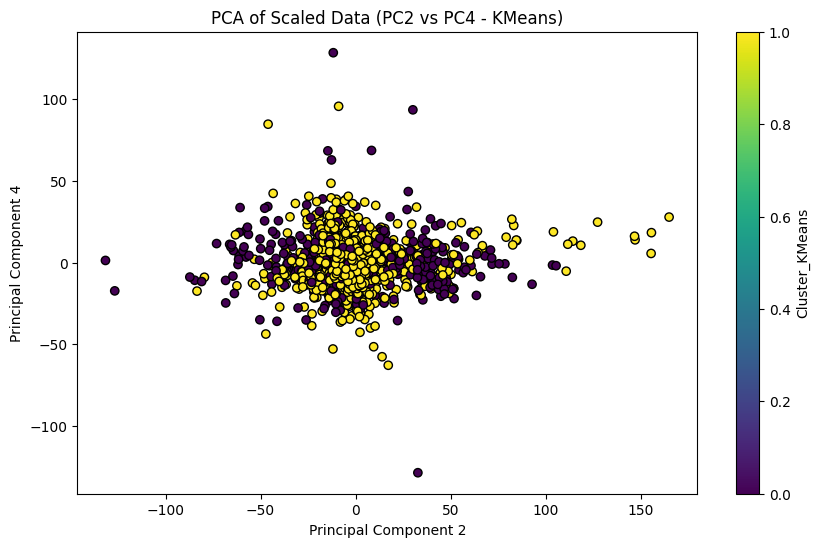

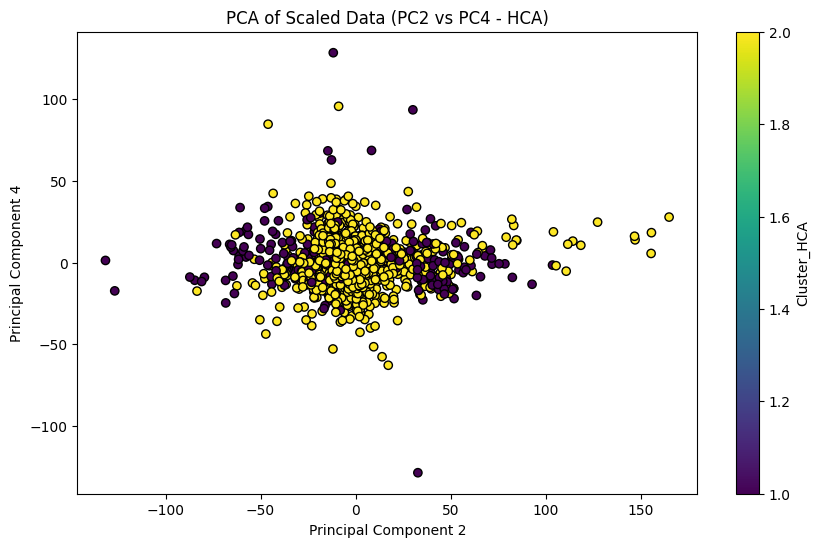

In [6]:
# Update the PCA plotting section for specific pairs (PC1 vs PC3, PC1 vs PC4, etc.)
pairs_to_plot = [(0, 2), (0, 3), (1, 3)]  # Adjust this list for other pairs you want to see

for (i, j) in pairs_to_plot:
    plt.figure(figsize=(10, 6))
    plt.scatter(pca_df_v2[f'Principal Component {i+1}'], pca_df_v2[f'Principal Component {j+1}'], c=pca_df_v2['Cluster_GMM'], cmap='viridis', marker='o', edgecolor='k')
    plt.xlabel(f'Principal Component {i+1}')
    plt.ylabel(f'Principal Component {j+1}')
    plt.title(f'PCA of Scaled Data (PC{i+1} vs PC{j+1} - GMM)')
    plt.colorbar(label='Cluster_GMM')
    plt.show()

    plt.figure(figsize=(10, 6))
    plt.scatter(pca_df_v2[f'Principal Component {i+1}'], pca_df_v2[f'Principal Component {j+1}'], c=pca_df_v2['Cluster_KMeans'], cmap='viridis', marker='o', edgecolor='k')
    plt.xlabel(f'Principal Component {i+1}')
    plt.ylabel(f'Principal Component {j+1}')
    plt.title(f'PCA of Scaled Data (PC{i+1} vs PC{j+1} - KMeans)')
    plt.colorbar(label='Cluster_KMeans')
    plt.show()

    plt.figure(figsize=(10, 6))
    plt.scatter(pca_df_v2[f'Principal Component {i+1}'], pca_df_v2[f'Principal Component {j+1}'], c=pca_df_v2['Cluster_HCA'], cmap='viridis', marker='o', edgecolor='k')
    plt.xlabel(f'Principal Component {i+1}')
    plt.ylabel(f'Principal Component {j+1}')
    plt.title(f'PCA of Scaled Data (PC{i+1} vs PC{j+1} - HCA)')
    plt.colorbar(label='Cluster_HCA')
    plt.show()


Label Encoding and Annotation Plot

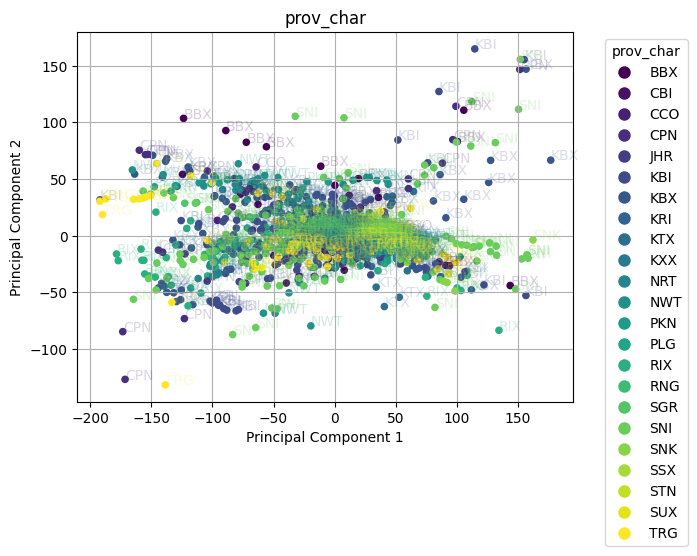

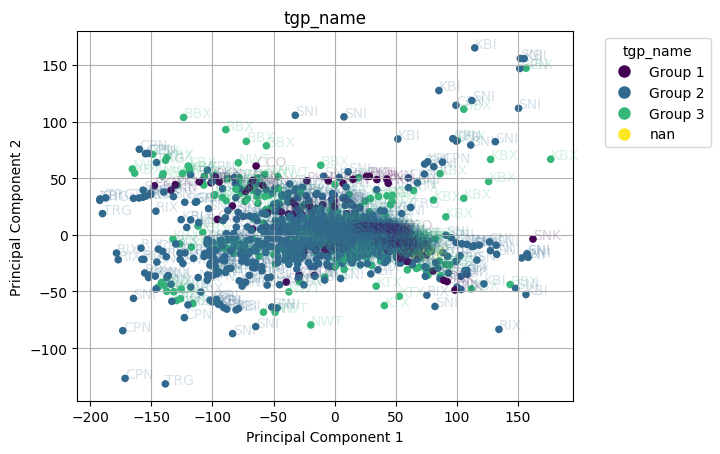

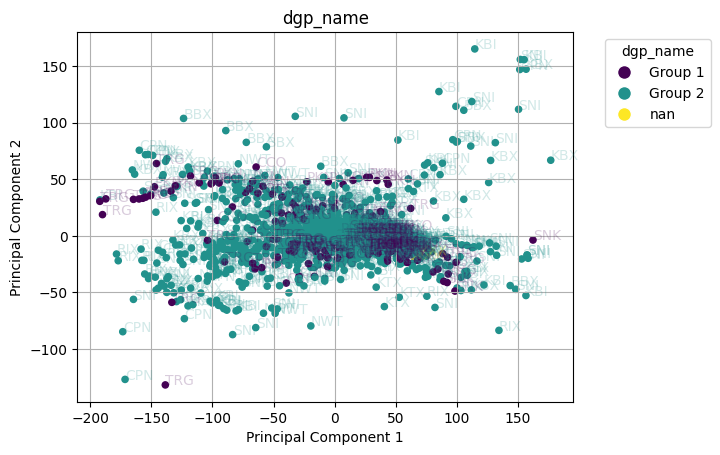

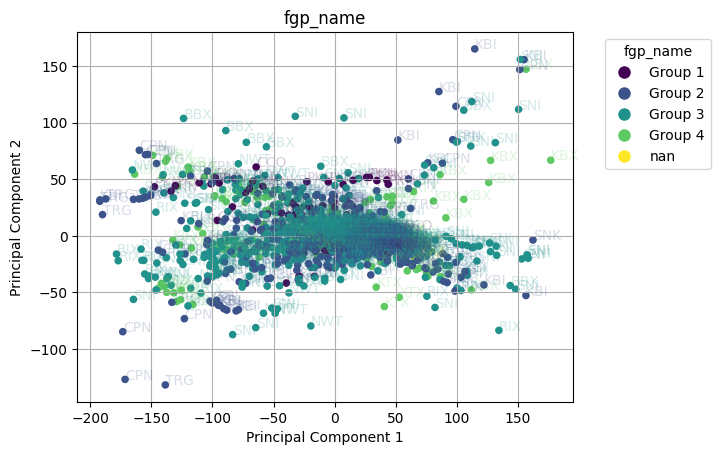

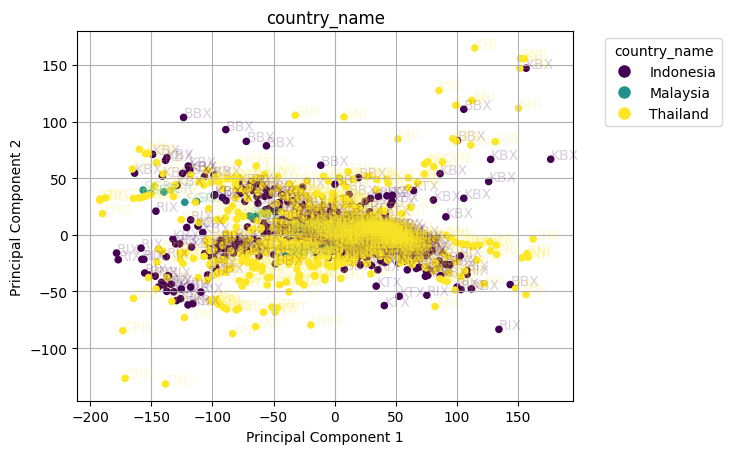

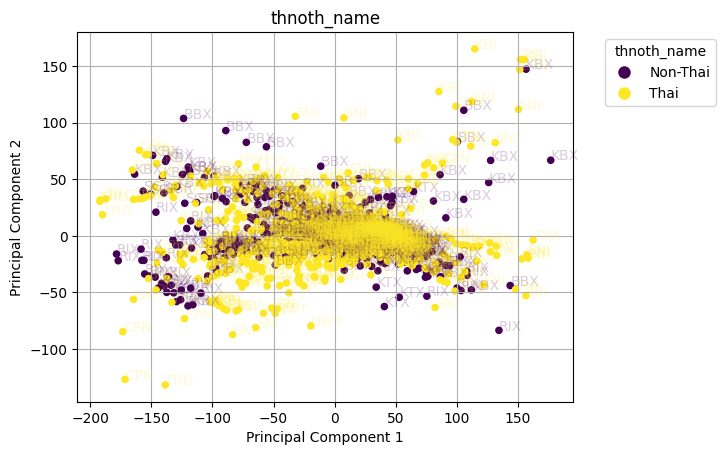

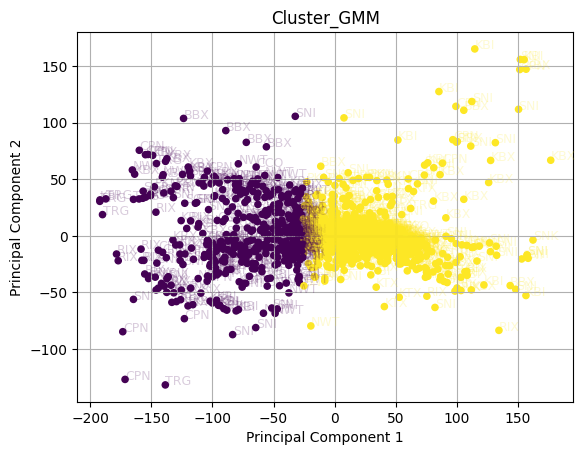

In [7]:
# Label encoding and annotation plot
label_encoder_v2 = LabelEncoder()

for i in range(len(string_cols_v2)):
    encoded_categories_v2 = label_encoder_v2.fit_transform(result_df_v2[string_cols_v2[i]])
    if i == 1:
        continue
    if i == 2:
        continue
    
    scatter_v2 = plt.scatter(result_df_v2['Principal Component 1'], result_df_v2['Principal Component 2'], 
                             c=encoded_categories_v2, cmap='viridis', s=20)
    plt.title(string_cols_v2[i])
    
    cmap_v2 = scatter_v2.cmap
    norm_v2 = scatter_v2.norm
    
    for j in range(len(result_df_v2)):
        plt.annotate(result_df_v2['prov_char'].iloc[j], 
                     (result_df_v2['Principal Component 1'].iloc[j], result_df_v2['Principal Component 2'].iloc[j]), 
                     color=cmap_v2(norm_v2(encoded_categories_v2[j])), alpha=0.2)
    
    unique_labels_v2 = label_encoder_v2.classes_
    handles_v2 = [plt.Line2D([0], [0], marker='o', color='w', label=label,
                          markersize=10, markerfacecolor=cmap_v2(norm_v2(value)))
               for value, label in enumerate(unique_labels_v2)]
    
    plt.legend(handles=handles_v2, title=string_cols_v2[i], bbox_to_anchor=(1.05, 1), loc='upper left')
 
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')

    plt.grid(True)
    plt.show()

plt.scatter(result_df_v2['Principal Component 1'], result_df_v2['Principal Component 2'], c=result_df_v2['Cluster_GMM'], cmap='viridis', s=20)
plt.title('Cluster_GMM')

for x, y, label, color in zip(result_df_v2['Principal Component 1'], 
                              result_df_v2['Principal Component 2'], 
                              result_df_v2['prov_char'], 
                              result_df_v2['Cluster_GMM']):
    plt.text(x, y, label, color=plt.cm.viridis(color / max(result_df_v2['Cluster_GMM'])), fontsize=9, alpha=0.2)

plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

plt.grid(True)
plt.show()
